# 오늘 학습할 것

- 데이터셋 파이프라인을 통해 데이터 전처리

- 이미지 처리 관련 라이브러리 

- 위의 이미지 처리 과정을 파이프라인 상에서 수행할 수 있도록 구현

# 개와 고양이 이미지 준비


https://www.microsoft.com/en-us/download/details.aspx?id=54765

1. 다른 형식의 파일이 존재하는지 확인하고, 해당 파일을 제거
2. 우리가 사용할 이미지들 중에서 오류가 있는 이미지를 제거



In [1]:
import os
import tensorflow as tf

In [2]:
os.listdir('./dataset/pets/Dog')

['0.jpg',
 '1.jpg',
 '10.jpg',
 '100.jpg',
 '1000.jpg',
 '10000.jpg',
 '10001.jpg',
 '10002.jpg',
 '10003.jpg',
 '10004.jpg',
 '10005.jpg',
 '10006.jpg',
 '10007.jpg',
 '10008.jpg',
 '10009.jpg',
 '1001.jpg',
 '10010.jpg',
 '10011.jpg',
 '10012.jpg',
 '10013.jpg',
 '10014.jpg',
 '10015.jpg',
 '10016.jpg',
 '10017.jpg',
 '10018.jpg',
 '10019.jpg',
 '1002.jpg',
 '10020.jpg',
 '10021.jpg',
 '10022.jpg',
 '10023.jpg',
 '10024.jpg',
 '10025.jpg',
 '10026.jpg',
 '10027.jpg',
 '10028.jpg',
 '10029.jpg',
 '1003.jpg',
 '10030.jpg',
 '10031.jpg',
 '10032.jpg',
 '10033.jpg',
 '10034.jpg',
 '10035.jpg',
 '10036.jpg',
 '10037.jpg',
 '10038.jpg',
 '10039.jpg',
 '1004.jpg',
 '10040.jpg',
 '10041.jpg',
 '10042.jpg',
 '10043.jpg',
 '10044.jpg',
 '10045.jpg',
 '10046.jpg',
 '10047.jpg',
 '10048.jpg',
 '10049.jpg',
 '1005.jpg',
 '10050.jpg',
 '10051.jpg',
 '10052.jpg',
 '10053.jpg',
 '10054.jpg',
 '10055.jpg',
 '10056.jpg',
 '10057.jpg',
 '10058.jpg',
 '10059.jpg',
 '1006.jpg',
 '10060.jpg',
 '10061.jpg'

In [6]:
# 1. 다른 형식의 파일을 제거

for path in os.listdir('./dataset/pets/Dog'):
    # 파일의 경로에 파일의 형식 명시
    _, exe = os.path.splitext(path)
    if exe != '.jpg':
        # 이미지가 아닌 경우에는
        print(path)
        os.remove('./dataset/pets/Dog/' + path)

In [8]:
for path in os.listdir('./dataset/pets/Cat'):
    # 파일의 경로에 파일의 형식 명시
    _, exe = os.path.splitext(path)
    if exe != '.jpg':
        # 이미지가 아닌 경우에는
        print(path)
        os.remove('./dataset/pets/Cat/' + path)

In [10]:
# 2. 이미지들 중에서 오류가 있는 이미지를 제거
# 이미지 저장시의 에러 처리

num_skipped = 0
for folder_name in ("Cat", "Dog"):
    # 이부분 반드시 변경이 필요하다.
    folder_path = os.path.join("./dataset/pets", folder_name)
    for fname in os.listdir(folder_path):
        fpath = os.path.join(folder_path, fname) # PetImages/Cat/63.jpg
        try:
            fobj = open(fpath, "rb")
            # fobj.peek(10)은 10바이트를 가져오는데, 여기서는 보통
            # 헤더를 읽기 위해 전체를 가져온다고 생각해도 무방합니다.
            is_jfif = tf.compat.as_bytes("JFIF") in fobj.peek(10)
        finally:
            fobj.close()
        
        # JFIF의 헤더를 들고 있지 않으면 손상된 파일이므로 삭제    
        if not is_jfif:
            num_skipped += 1
            os.remove(fpath)
print(num_skipped)

0


# 데이터 파이프라인 구축하기

# 첫 번째 방법 - tf.data.Dataset 사용


### image_dataset_from_directory

```python
tf.keras.preprocessing.image_dataset_from_directory(
    directory,
    labels="inferred",
    label_mode="int",
    class_names=None,
    color_mode="rgb",
    batch_size=32,
    image_size=(256, 256),
    shuffle=True,
    seed=None,
    validation_split=None,
    subset=None,
    interpolation="bilinear",
    follow_links=False,
)
```

### returns

tf.data.Dataset의 타입, 경로에 저장되어있는 이미지 파일들을 데이터셋으로 구성하여 반환한다. 


### label_mode 


1. label_mode = 'int'

    카테고리의 값을 정수 값으로 반환하여 전달 
    
    label의 경우, (batch_size, )의 shape를 가진다.
    
    y값에 따라 학습루프 정의시에 loss가 달라지는데, sparse_categorical_crossentropy


2. label_mode = 'categorical'

    카테고리의 값을 디렉토리의 이름으로 전달 
    
    label의 경우, one-hot encoding되어 전달된다.
    
    label의 shape가 (batch_size, class의 갯수)가 된다.
      
    loss는 categorical_crossentropy를 사용해야한다.

3. label_mode = 'binary'

   카테고리를 이진 값으로 변환하여 전달 
      
   label의 경우, (batch_size, 1)의 shape, dtype이 float32를 사용한다.
   
   (0.0, 1.0) 둘 중 하나의 값을 가진다.
   
   loss는 binary_crossentropy를 사용해야 한다.
   
   
### subset

하나의 학습 데이터에서 train set와 validation set으로 분류하기 위해 해당 tf.data.Dataset이 어떠한 용도로 사용될 것인가에 대한 명시

- 'training'

- 'validation'


### seed

train set, validation set의 중복을 제거하기 위해 동일한 값을 사용한다.


### validation_split

train set - validation set의 비율을 설정하기 위해 사용한다.

0.3 -> 70% - 30% 


In [13]:
# cat - dog 데이터셋을 하나 만들자.

train_dataset = tf.keras.preprocessing.image_dataset_from_directory(
    './dataset/pets',
    label_mode = 'categorical',
    batch_size = 50,
    subset = 'training',
    validation_split = 0.1,
    seed = 6309
)

Found 23422 files belonging to 2 classes.
Using 21080 files for training.


In [14]:

val_dataset = tf.keras.preprocessing.image_dataset_from_directory(
    './dataset/pets',
    label_mode = 'categorical',
    batch_size = 50,
    subset = 'validation',
    validation_split = 0.1,
    seed = 8309
    
)

Found 23422 files belonging to 2 classes.
Using 2342 files for validation.


In [12]:
train_dataset

<BatchDataset shapes: ((None, 256, 256, 3), (None, 2)), types: (tf.float32, tf.float32)>

In [15]:
val_dataset

<BatchDataset shapes: ((None, 256, 256, 3), (None, 2)), types: (tf.float32, tf.float32)>

In [16]:
# 첫번째 데이터를 보고 싶다.
val_dataset[0]

TypeError: 'BatchDataset' object is not subscriptable

### BatchDataset

`tf.keras.preprocessing.image_dataset_from_directory` 을 통해 파이프라인을 구축하는 경우, 반환되는 데이터 파이프라인 객체를 말한다.


- 모든 데이터가 batch_size만큼 나뉘어져 있다.

- 해당 객체는 모든 이미지 데이터를 저장하고 있는 것이 아니라, 필요한 이미지를 batch_size만큼 메모리로 로드하는 방식이기 때문에 indexing이 불가능하다. 


- indexing을 하도록 만들고 싶다면, list(dataset.as_numpy_iterator())을 통해 배열의 형태로 변환할 수 있다. 큰 데이터셋의 경우에는 이러한 코드가 굉장히 위험하다. 

- for문을 통해서 데이터 로드가 가능하다. 데이터셋을 일반적으로 fit(), map()의 함수로 사용하기 때문에 이외의 기능은 제공하지 않는다.

- 0-255의 값을 가지지만, dtype은 tf.float32이다. -> PIL을 사용하여 이미지를 불러올 때, 고려해야한다.


#### batch

BatchDataset의 원소 하나, batch_size크기로 나뉘어지는 데이터들의 집합 


In [22]:
# cardinality()

# 422개의 batch로 구성되어있다.
total_size = train_dataset.cardinality().numpy()

In [24]:
# 모든 데이터가 batch의 형태로 존재하기 때문에 
# x, y
for images, labels in train_dataset:
    print(images.shape)

(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 256, 3)
(50, 256, 

In [27]:
# for 문이 아닌 방법으로 batch를 들고오기 

batchs = train_dataset.take(1)

In [28]:
# 422개 중, 1개의 batch를 들고왔다.  
batchs

<TakeDataset shapes: ((None, 256, 256, 3), (None, 2)), types: (tf.float32, tf.float32)>

In [32]:
import PIL

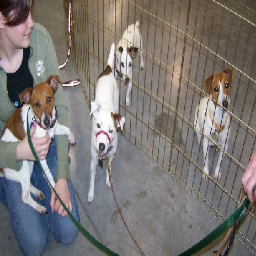

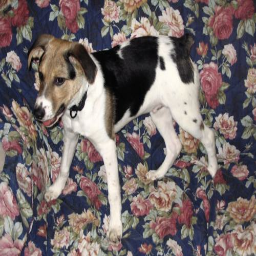

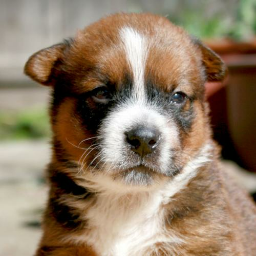

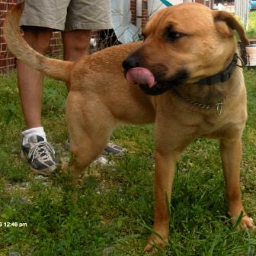

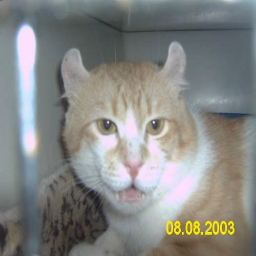

...

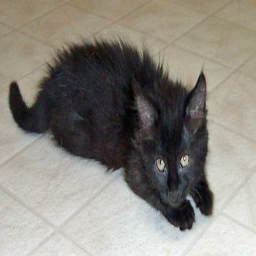

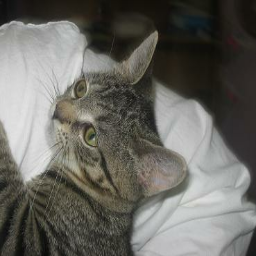

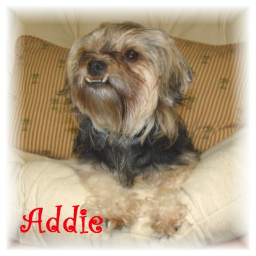

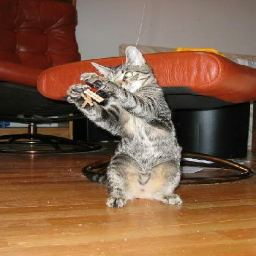

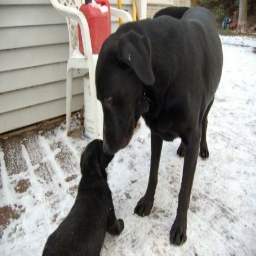

In [34]:
# batch 1개로 구성된 TakeDataset
for images, labels in batchs:
    # batch_size만큼의 images에서 각 image들을 로드한다.
    for image in images:
        # tensor -> image의 array, PIL이라는 이미지를 다루는 라이브러리에서 'uint8' 형식을 지원하기 때문에
        image_array = image.numpy().astype('uint8')
        # image의 array에서 PIL image 객체로 
        pil_image = PIL.Image.fromarray(image_array)
        display(pil_image)
        

### batch size가 50 -> 10으로 바꿔보자.

In [35]:
# batch size가 존재하지 않는 데이터셋
new_batch_set = train_dataset.unbatch()

In [36]:
# batch size를 설정하자
new_batch_set = new_batch_set.batch(10)

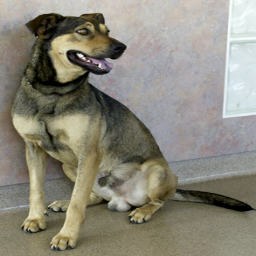

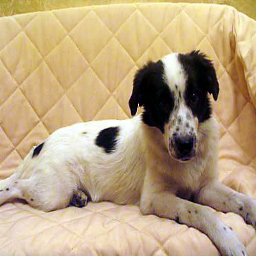

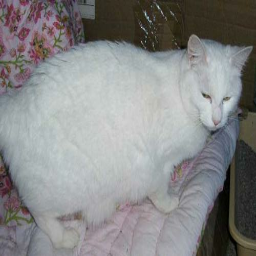

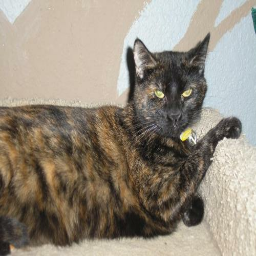

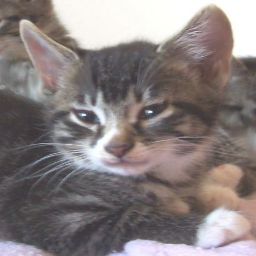

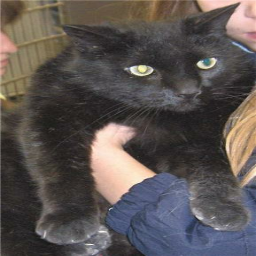

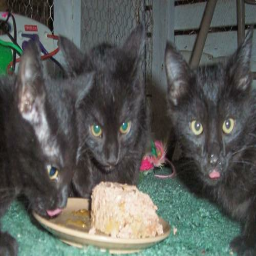

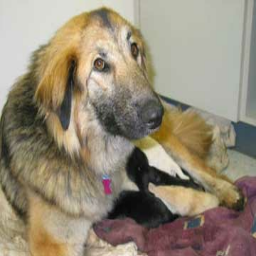

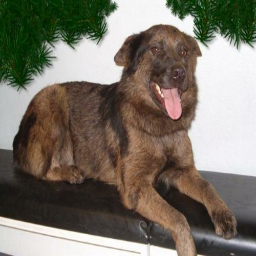

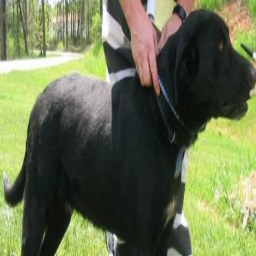

In [37]:
# batch 1개로 구성된 TakeDataset
for images, labels in new_batch_set.take(1):
    # batch_size만큼의 images에서 각 image들을 로드한다.
    for image in images:
        # tensor -> image의 array, PIL이라는 이미지를 다루는 라이브러리에서 'uint8' 형식을 지원하기 때문에
        image_array = image.numpy().astype('uint8')
        # image의 array에서 PIL image 객체로 
        pil_image = PIL.Image.fromarray(image_array)
        display(pil_image)
        

## tf.data.Dataset의 여러가지 메소드


#### take()


#### unbatch(), batch()


#### .as_numpy_iterator()


#### .shuffle()


#### .concatenate()


#### .map()

In [38]:
easy_dataset = tf.data.Dataset.range(100)

In [41]:
# indexing을 가능하게 하려면, list(.as_numpy_iterator())
easy_list = list(easy_dataset.as_numpy_iterator())

In [45]:
easy_list

[0,
 1,
 2,
 3,
 4,
 5,
 6,
 7,
 8,
 9,
 10,
 11,
 12,
 13,
 14,
 15,
 16,
 17,
 18,
 19,
 20,
 21,
 22,
 23,
 24,
 25,
 26,
 27,
 28,
 29,
 30,
 31,
 32,
 33,
 34,
 35,
 36,
 37,
 38,
 39,
 40,
 41,
 42,
 43,
 44,
 45,
 46,
 47,
 48,
 49,
 50,
 51,
 52,
 53,
 54,
 55,
 56,
 57,
 58,
 59,
 60,
 61,
 62,
 63,
 64,
 65,
 66,
 67,
 68,
 69,
 70,
 71,
 72,
 73,
 74,
 75,
 76,
 77,
 78,
 79,
 80,
 81,
 82,
 83,
 84,
 85,
 86,
 87,
 88,
 89,
 90,
 91,
 92,
 93,
 94,
 95,
 96,
 97,
 98,
 99]

### batch() - unbatch()

In [48]:
# batch()
batch_easy_dataset = easy_dataset.batch(5)

In [49]:
list(batch_easy_dataset.as_numpy_iterator())

[array([0, 1, 2, 3, 4], dtype=int64),
 array([5, 6, 7, 8, 9], dtype=int64),
 array([10, 11, 12, 13, 14], dtype=int64),
 array([15, 16, 17, 18, 19], dtype=int64),
 array([20, 21, 22, 23, 24], dtype=int64),
 array([25, 26, 27, 28, 29], dtype=int64),
 array([30, 31, 32, 33, 34], dtype=int64),
 array([35, 36, 37, 38, 39], dtype=int64),
 array([40, 41, 42, 43, 44], dtype=int64),
 array([45, 46, 47, 48, 49], dtype=int64),
 array([50, 51, 52, 53, 54], dtype=int64),
 array([55, 56, 57, 58, 59], dtype=int64),
 array([60, 61, 62, 63, 64], dtype=int64),
 array([65, 66, 67, 68, 69], dtype=int64),
 array([70, 71, 72, 73, 74], dtype=int64),
 array([75, 76, 77, 78, 79], dtype=int64),
 array([80, 81, 82, 83, 84], dtype=int64),
 array([85, 86, 87, 88, 89], dtype=int64),
 array([90, 91, 92, 93, 94], dtype=int64),
 array([95, 96, 97, 98, 99], dtype=int64)]

In [50]:
list(batch_easy_dataset.batch(3).as_numpy_iterator())

[array([[ 0,  1,  2,  3,  4],
        [ 5,  6,  7,  8,  9],
        [10, 11, 12, 13, 14]], dtype=int64),
 array([[15, 16, 17, 18, 19],
        [20, 21, 22, 23, 24],
        [25, 26, 27, 28, 29]], dtype=int64),
 array([[30, 31, 32, 33, 34],
        [35, 36, 37, 38, 39],
        [40, 41, 42, 43, 44]], dtype=int64),
 array([[45, 46, 47, 48, 49],
        [50, 51, 52, 53, 54],
        [55, 56, 57, 58, 59]], dtype=int64),
 array([[60, 61, 62, 63, 64],
        [65, 66, 67, 68, 69],
        [70, 71, 72, 73, 74]], dtype=int64),
 array([[75, 76, 77, 78, 79],
        [80, 81, 82, 83, 84],
        [85, 86, 87, 88, 89]], dtype=int64),
 array([[90, 91, 92, 93, 94],
        [95, 96, 97, 98, 99]], dtype=int64)]

## shuffle()

In [51]:
shuffle_easy_dataset = batch_easy_dataset.shuffle(20)

In [52]:
list(shuffle_easy_dataset.as_numpy_iterator())

[array([30, 31, 32, 33, 34], dtype=int64),
 array([20, 21, 22, 23, 24], dtype=int64),
 array([45, 46, 47, 48, 49], dtype=int64),
 array([25, 26, 27, 28, 29], dtype=int64),
 array([90, 91, 92, 93, 94], dtype=int64),
 array([5, 6, 7, 8, 9], dtype=int64),
 array([60, 61, 62, 63, 64], dtype=int64),
 array([70, 71, 72, 73, 74], dtype=int64),
 array([50, 51, 52, 53, 54], dtype=int64),
 array([55, 56, 57, 58, 59], dtype=int64),
 array([15, 16, 17, 18, 19], dtype=int64),
 array([85, 86, 87, 88, 89], dtype=int64),
 array([75, 76, 77, 78, 79], dtype=int64),
 array([40, 41, 42, 43, 44], dtype=int64),
 array([95, 96, 97, 98, 99], dtype=int64),
 array([65, 66, 67, 68, 69], dtype=int64),
 array([10, 11, 12, 13, 14], dtype=int64),
 array([80, 81, 82, 83, 84], dtype=int64),
 array([35, 36, 37, 38, 39], dtype=int64),
 array([0, 1, 2, 3, 4], dtype=int64)]

In [56]:
only1_dataset = tf.data.Dataset.from_tensors(1).repeat(100)
only0_dataset = tf.data.Dataset.from_tensors(0).repeat(100)

In [57]:
# 
unbalance_dataset = only1_dataset.concatenate(only0_dataset)

In [58]:
# 고양이 사진만 있는 데이터셋 - 개 사진만 있는 데이터셋
list(unbalance_dataset.as_numpy_iterator())

[1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0]

### shuffle() 필요한 이유

지금까지는 우리가 수집한 데이터가 카테고리로 잘 분류되어있었다. 하나의 디렉토리 내에 Cat - Dog에 고양이, 개 사진이 들어가있다.

하지만 수집한 데이터가 하나의 디렉토리에 구분되어있지 않고, 각각의 데이터셋을 결합해야할 때를 생각해보자.

개 사진만 가진 데이터셋 + 고양이 사진만 가진 데이터셋 => 학습 데이터셋

학습의 과정이 한 번의 가중치 갱신의 과정에서 개와 고양이를 고루 학습하는 것이 아니라, 개에 대한 가중치 갱신 -> 고양이에 대한 가중치 갱신


학습하는 데이터가 순서상 편향되어있을 경우, 학습이 제대로 이루어지지 않습니다. 그러므로 데이터들이 고르게 분포될 수 있도록 반드시 섞어줘야합니다.

In [59]:
# 고양이 사진만 있는 데이터셋 - 개 사진만 있는 데이터셋
list(unbalance_dataset.batch(20).as_numpy_iterator())

[array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]),
 array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]),
 array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]),
 array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]),
 array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]),
 array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]),
 array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]),
 array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]),
 array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]),
 array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])]

In [60]:
list(unbalance_dataset.shuffle(200).batch(20).as_numpy_iterator())

[array([0, 0, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0]),
 array([1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0]),
 array([1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0]),
 array([0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0]),
 array([1, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1]),
 array([0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0]),
 array([1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1]),
 array([0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0]),
 array([0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0]),
 array([1, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0])]

### map()

모든 원소에 대해서 연산작업을 실시하는 사용자 정의 함수를 수행하는 메소드

In [61]:
# 원소에 대한 연산 작업을 실시하는 사용자 정의 함수

def plus_1(element):
    # 각 원소
    element = element + 1
    return element

In [63]:
plus1_dataset = batch_easy_dataset.map(plus_1)

In [65]:
list(batch_easy_dataset.as_numpy_iterator())

[array([0, 1, 2, 3, 4], dtype=int64),
 array([5, 6, 7, 8, 9], dtype=int64),
 array([10, 11, 12, 13, 14], dtype=int64),
 array([15, 16, 17, 18, 19], dtype=int64),
 array([20, 21, 22, 23, 24], dtype=int64),
 array([25, 26, 27, 28, 29], dtype=int64),
 array([30, 31, 32, 33, 34], dtype=int64),
 array([35, 36, 37, 38, 39], dtype=int64),
 array([40, 41, 42, 43, 44], dtype=int64),
 array([45, 46, 47, 48, 49], dtype=int64),
 array([50, 51, 52, 53, 54], dtype=int64),
 array([55, 56, 57, 58, 59], dtype=int64),
 array([60, 61, 62, 63, 64], dtype=int64),
 array([65, 66, 67, 68, 69], dtype=int64),
 array([70, 71, 72, 73, 74], dtype=int64),
 array([75, 76, 77, 78, 79], dtype=int64),
 array([80, 81, 82, 83, 84], dtype=int64),
 array([85, 86, 87, 88, 89], dtype=int64),
 array([90, 91, 92, 93, 94], dtype=int64),
 array([95, 96, 97, 98, 99], dtype=int64)]

In [64]:
list(plus1_dataset.as_numpy_iterator())

[array([1, 2, 3, 4, 5], dtype=int64),
 array([ 6,  7,  8,  9, 10], dtype=int64),
 array([11, 12, 13, 14, 15], dtype=int64),
 array([16, 17, 18, 19, 20], dtype=int64),
 array([21, 22, 23, 24, 25], dtype=int64),
 array([26, 27, 28, 29, 30], dtype=int64),
 array([31, 32, 33, 34, 35], dtype=int64),
 array([36, 37, 38, 39, 40], dtype=int64),
 array([41, 42, 43, 44, 45], dtype=int64),
 array([46, 47, 48, 49, 50], dtype=int64),
 array([51, 52, 53, 54, 55], dtype=int64),
 array([56, 57, 58, 59, 60], dtype=int64),
 array([61, 62, 63, 64, 65], dtype=int64),
 array([66, 67, 68, 69, 70], dtype=int64),
 array([71, 72, 73, 74, 75], dtype=int64),
 array([76, 77, 78, 79, 80], dtype=int64),
 array([81, 82, 83, 84, 85], dtype=int64),
 array([86, 87, 88, 89, 90], dtype=int64),
 array([91, 92, 93, 94, 95], dtype=int64),
 array([ 96,  97,  98,  99, 100], dtype=int64)]

In [66]:
# map 함수는 기존 shape에 무관하게 동작한다. -> 원소별 수행으로 동작하기 때문에 아래의 과정으로 shape가 변환된다.

def append_dim(element):
    return [element, element * 2]

In [68]:
dim_dataset = batch_easy_dataset.map(append_dim)

[0, 1, 2, 3, 4] -> [[0, 0], [1, 2], [2, 4], [3, 6], [4, 8]] -> ([0, 1, 2, 3, 4], [0, 2, 4, 6, 8])

In [69]:
list(dim_dataset.as_numpy_iterator())

[(array([0, 1, 2, 3, 4], dtype=int64), array([0, 2, 4, 6, 8], dtype=int64)),
 (array([5, 6, 7, 8, 9], dtype=int64),
  array([10, 12, 14, 16, 18], dtype=int64)),
 (array([10, 11, 12, 13, 14], dtype=int64),
  array([20, 22, 24, 26, 28], dtype=int64)),
 (array([15, 16, 17, 18, 19], dtype=int64),
  array([30, 32, 34, 36, 38], dtype=int64)),
 (array([20, 21, 22, 23, 24], dtype=int64),
  array([40, 42, 44, 46, 48], dtype=int64)),
 (array([25, 26, 27, 28, 29], dtype=int64),
  array([50, 52, 54, 56, 58], dtype=int64)),
 (array([30, 31, 32, 33, 34], dtype=int64),
  array([60, 62, 64, 66, 68], dtype=int64)),
 (array([35, 36, 37, 38, 39], dtype=int64),
  array([70, 72, 74, 76, 78], dtype=int64)),
 (array([40, 41, 42, 43, 44], dtype=int64),
  array([80, 82, 84, 86, 88], dtype=int64)),
 (array([45, 46, 47, 48, 49], dtype=int64),
  array([90, 92, 94, 96, 98], dtype=int64)),
 (array([50, 51, 52, 53, 54], dtype=int64),
  array([100, 102, 104, 106, 108], dtype=int64)),
 (array([55, 56, 57, 58, 59], dty

### 실제 데이터에 map() 사용해보기

tf.data.Dataset을 사용하여 파이프라인 구축시, 필요한 데이터 전처리를 구현해야한다.

- 255로 나누는 작업 -> [0, 1]

- 다양한 이미지 입력을 동일한 이미지 크기로 resizing

In [70]:
train_dataset = tf.keras.preprocessing.image_dataset_from_directory(
    './dataset/pets',
    label_mode = 'categorical',
    batch_size = 50,
    subset = 'training',
    validation_split = 0.1,
    seed = 6309
)

Found 23422 files belonging to 2 classes.
Using 21080 files for training.


In [71]:
# batch dataset -> image, label
train_dataset

<BatchDataset shapes: ((None, 256, 256, 3), (None, 2)), types: (tf.float32, tf.float32)>

In [75]:
# 사용자 정의함수
# batch size만큼의 이미지, 라벨로 나뉘어 인자로 받는다. -> map()의 함수는 원소별 수행이므로 한개의 이미지, 한개의 라벨을 인자로 받는다.
def resize_and_rescale(image, label):
    
    # resize (256, 256, 3) -> (144, 144, 3)
    image = tf.image.resize(image, [144, 144])

    # rescale
    image = image / 255.0
    
    return image, label

In [76]:
preprocessing_dataset = train_dataset.take(3).map(resize_and_rescale)

(144, 144, 3)


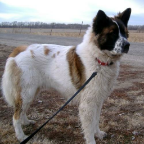

(144, 144, 3)


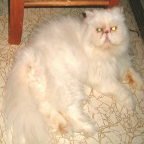

(144, 144, 3)


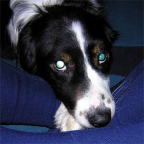

(144, 144, 3)


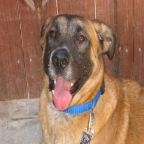

(144, 144, 3)


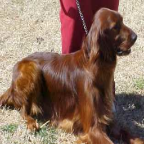

(144, 144, 3)


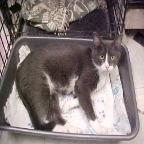

(144, 144, 3)


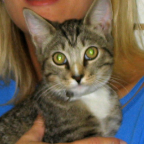

(144, 144, 3)


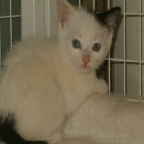

(144, 144, 3)


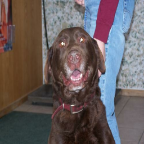

(144, 144, 3)


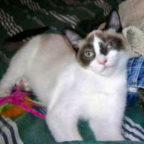

(144, 144, 3)


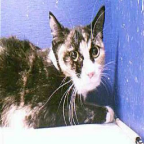

(144, 144, 3)


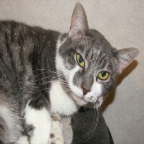

(144, 144, 3)


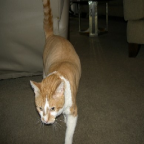

(144, 144, 3)


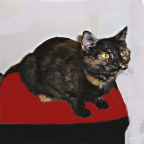

(144, 144, 3)


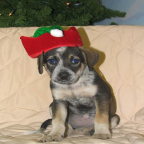

(144, 144, 3)


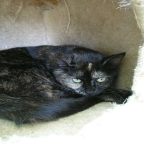

(144, 144, 3)


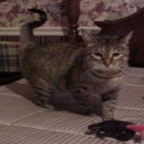

(144, 144, 3)


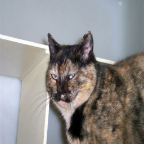

(144, 144, 3)


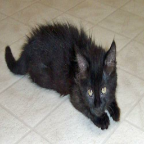

(144, 144, 3)


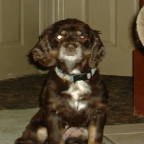

(144, 144, 3)


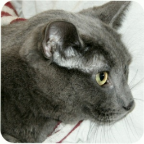

(144, 144, 3)


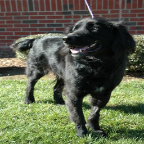

(144, 144, 3)


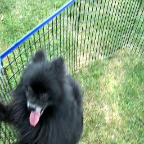

(144, 144, 3)


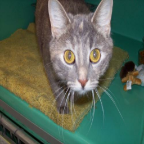

(144, 144, 3)


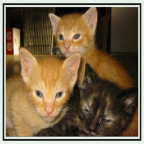

(144, 144, 3)


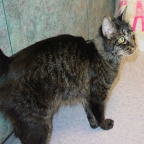

(144, 144, 3)


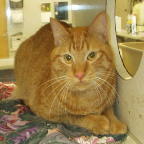

(144, 144, 3)


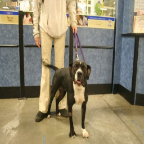

(144, 144, 3)


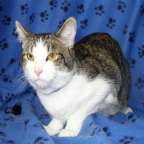

(144, 144, 3)


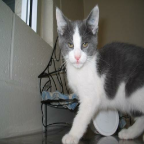

(144, 144, 3)


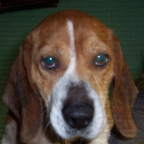

(144, 144, 3)


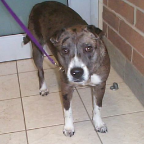

(144, 144, 3)


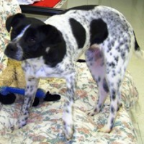

(144, 144, 3)


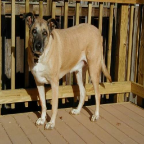

(144, 144, 3)


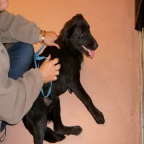

(144, 144, 3)


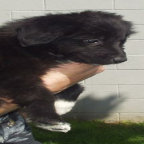

(144, 144, 3)


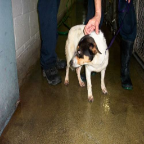

(144, 144, 3)


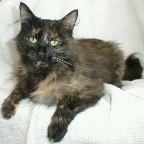

(144, 144, 3)


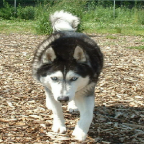

(144, 144, 3)


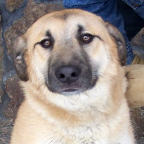

(144, 144, 3)


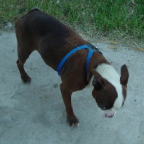

(144, 144, 3)


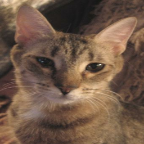

(144, 144, 3)


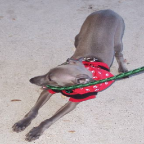

(144, 144, 3)


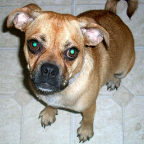

(144, 144, 3)


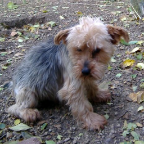

(144, 144, 3)


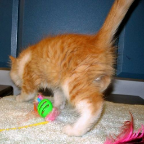

(144, 144, 3)


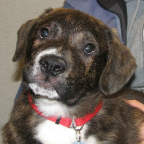

(144, 144, 3)


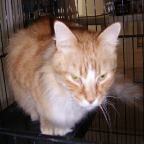

(144, 144, 3)


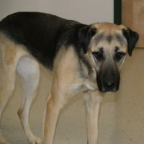

(144, 144, 3)


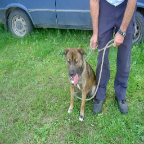

(144, 144, 3)


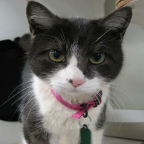

(144, 144, 3)


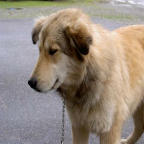

(144, 144, 3)


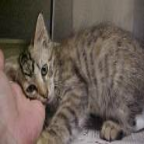

(144, 144, 3)


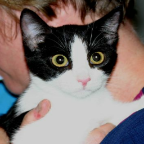

(144, 144, 3)


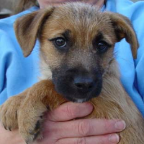

(144, 144, 3)


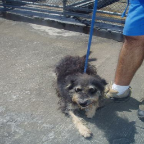

(144, 144, 3)


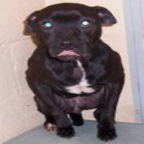

(144, 144, 3)


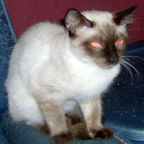

(144, 144, 3)


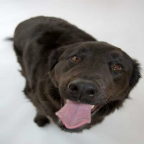

(144, 144, 3)


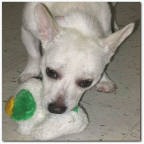

(144, 144, 3)


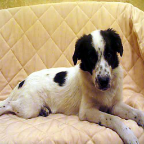

(144, 144, 3)


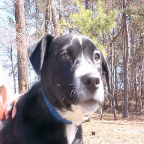

(144, 144, 3)


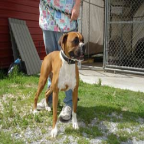

(144, 144, 3)


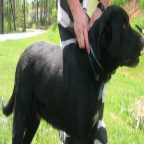

(144, 144, 3)


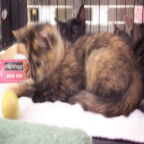

(144, 144, 3)


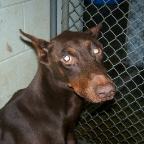

(144, 144, 3)


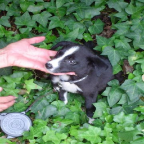

(144, 144, 3)


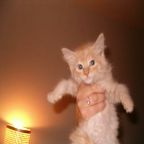

(144, 144, 3)


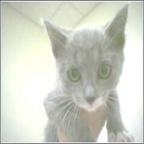

(144, 144, 3)


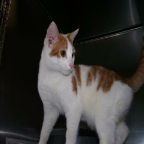

(144, 144, 3)


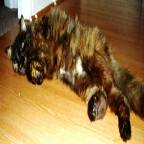

(144, 144, 3)


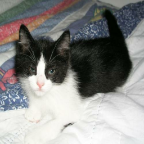

(144, 144, 3)


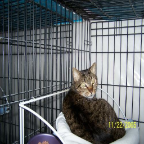

(144, 144, 3)


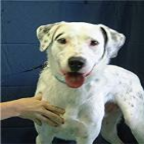

(144, 144, 3)


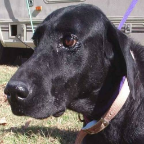

(144, 144, 3)


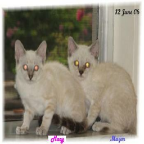

(144, 144, 3)


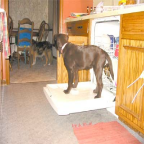

(144, 144, 3)


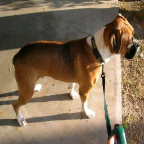

(144, 144, 3)


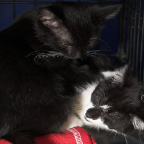

(144, 144, 3)


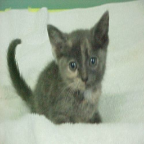

(144, 144, 3)


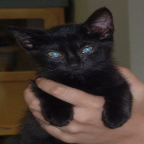

(144, 144, 3)


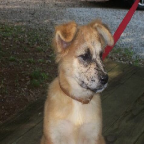

(144, 144, 3)


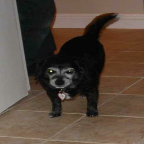

(144, 144, 3)


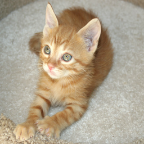

(144, 144, 3)


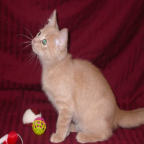

(144, 144, 3)


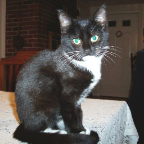

(144, 144, 3)


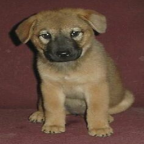

(144, 144, 3)


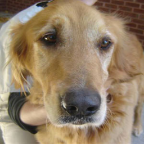

(144, 144, 3)


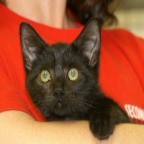

(144, 144, 3)


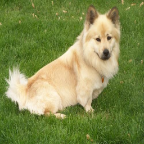

(144, 144, 3)


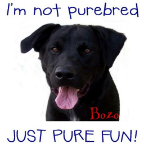

(144, 144, 3)


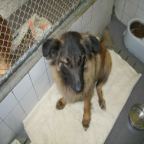

(144, 144, 3)


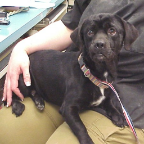

(144, 144, 3)


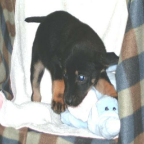

(144, 144, 3)


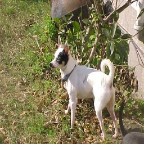

(144, 144, 3)


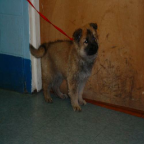

(144, 144, 3)


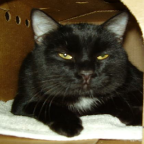

(144, 144, 3)


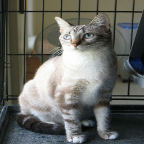

(144, 144, 3)


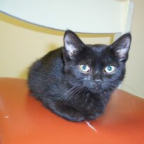

(144, 144, 3)


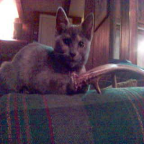

(144, 144, 3)


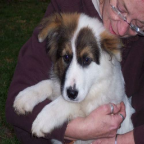

(144, 144, 3)


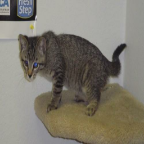

(144, 144, 3)


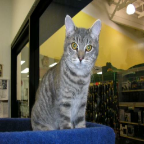

(144, 144, 3)


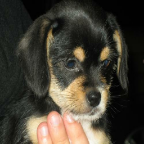

(144, 144, 3)


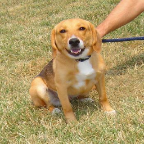

(144, 144, 3)


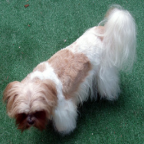

(144, 144, 3)


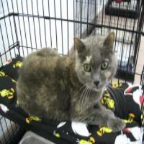

(144, 144, 3)


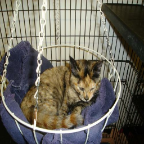

(144, 144, 3)


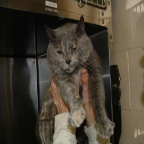

(144, 144, 3)


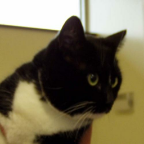

(144, 144, 3)


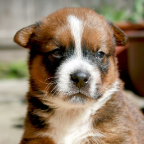

(144, 144, 3)


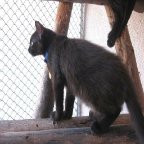

(144, 144, 3)


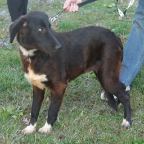

(144, 144, 3)


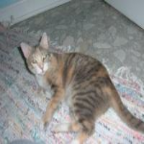

(144, 144, 3)


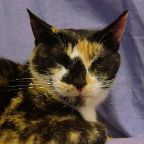

(144, 144, 3)


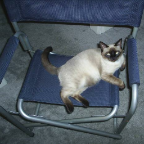

(144, 144, 3)


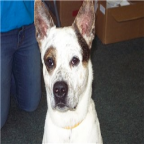

(144, 144, 3)


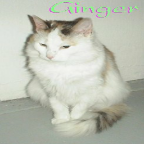

(144, 144, 3)


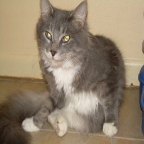

(144, 144, 3)


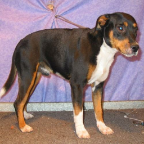

(144, 144, 3)


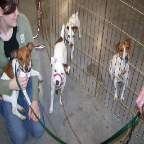

(144, 144, 3)


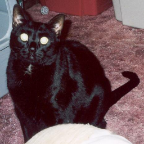

(144, 144, 3)


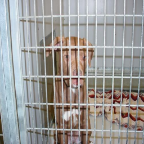

(144, 144, 3)


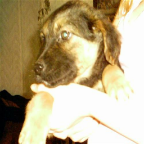

(144, 144, 3)


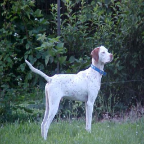

(144, 144, 3)


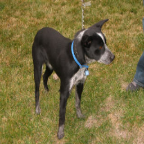

(144, 144, 3)


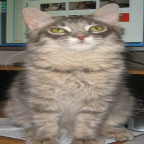

(144, 144, 3)


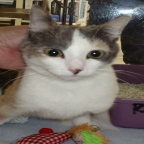

(144, 144, 3)


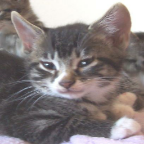

(144, 144, 3)


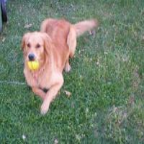

(144, 144, 3)


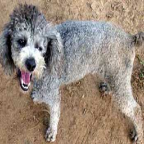

(144, 144, 3)


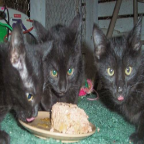

(144, 144, 3)


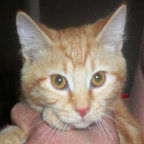

(144, 144, 3)


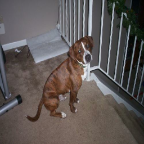

(144, 144, 3)


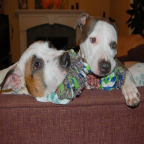

(144, 144, 3)


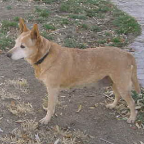

(144, 144, 3)


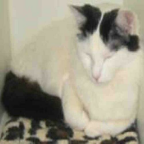

(144, 144, 3)


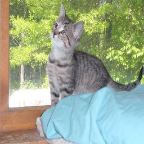

(144, 144, 3)


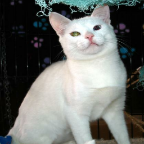

(144, 144, 3)


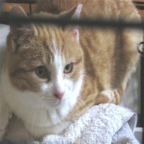

(144, 144, 3)


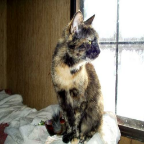

(144, 144, 3)


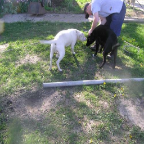

(144, 144, 3)


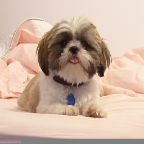

(144, 144, 3)


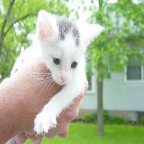

(144, 144, 3)


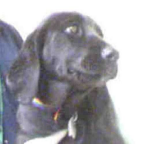

(144, 144, 3)


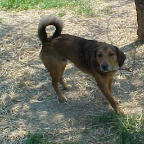

(144, 144, 3)


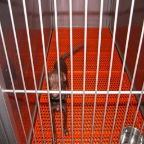

(144, 144, 3)


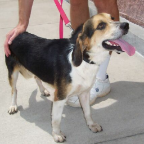

(144, 144, 3)


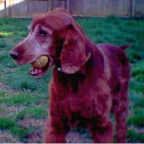

(144, 144, 3)


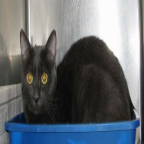

In [79]:
# batch 1개로 구성된 TakeDataset
for images, labels in preprocessing_dataset:

    for image in images:
        # rescale을 통해서 각 픽셀값이 0-255 -> 0-1 
        # 0-255의 값의 분포로 이미지를 인식하여 0-1사이의 값은 0으로 간주되어 매우 어둡게 나타난다.
        image_array = image.numpy().astype('uint8')
        print(image_array.shape)
        pil_image = PIL.Image.fromarray(image_array)
        display(pil_image)
        

In [91]:
#  tf.image 모듈 내에서 제공하는 함수를 통해 여러가지 전처리

def random_processing(image, label):
    
    # 랜덤하게 상하로 뒤집기
    up_down_image = tf.image.random_flip_up_down(image)
    
    # 랜덤하게 좌우로 뒤집기
    left_right_image = tf.image.random_flip_left_right(up_down_image)
    
    # 랜덤하게 밝기 조절하기
    brightness_image = tf.image.random_brightness(left_right_image, max_delta = 0.5)
    
    return brightness_image, label

In [92]:
preprocessing_dataset = train_dataset.take(3).map(random_processing)

(256, 256, 3)


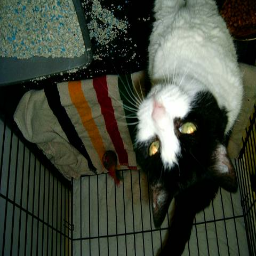

(256, 256, 3)


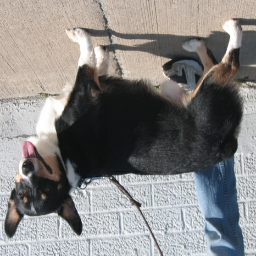

(256, 256, 3)


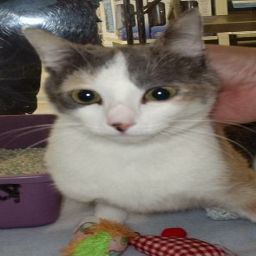

(256, 256, 3)


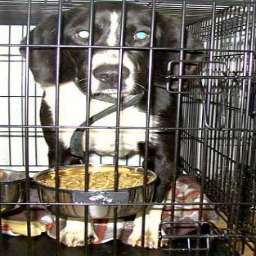

(256, 256, 3)


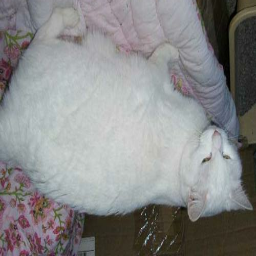

(256, 256, 3)


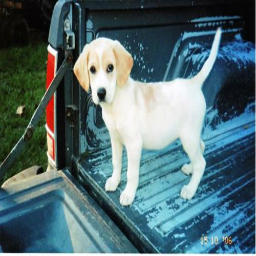

(256, 256, 3)


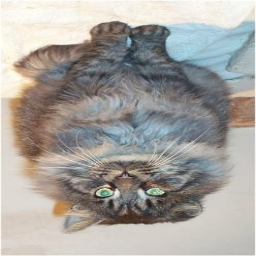

(256, 256, 3)


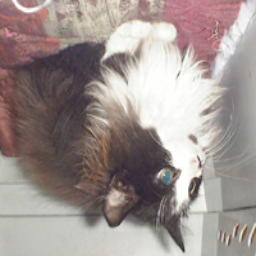

(256, 256, 3)


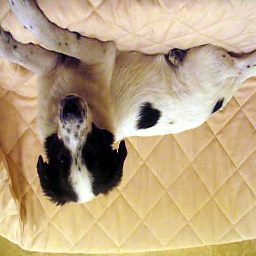

(256, 256, 3)


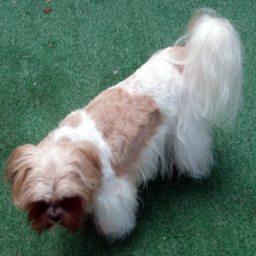

(256, 256, 3)


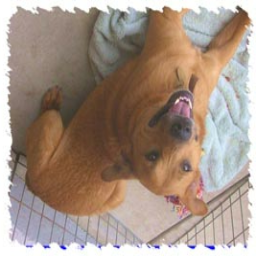

(256, 256, 3)


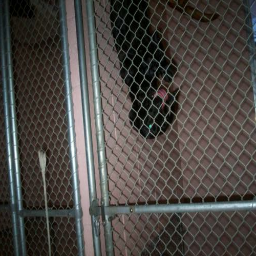

(256, 256, 3)


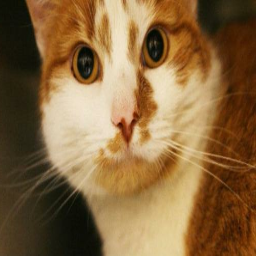

(256, 256, 3)


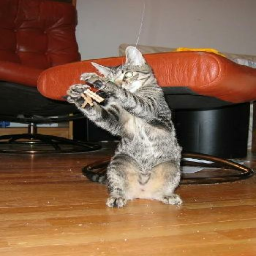

(256, 256, 3)


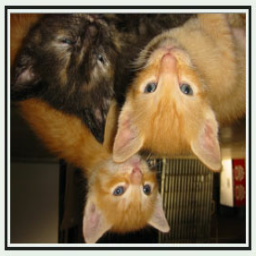

(256, 256, 3)


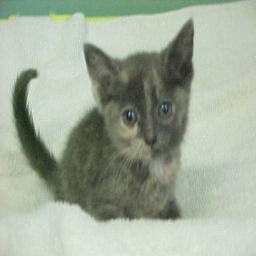

(256, 256, 3)


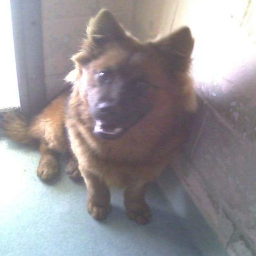

(256, 256, 3)


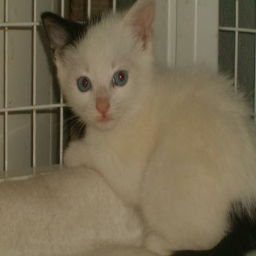

(256, 256, 3)


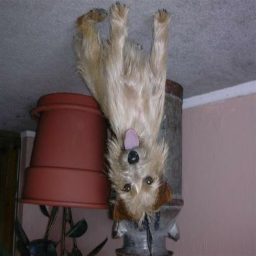

(256, 256, 3)


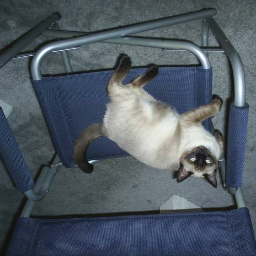

(256, 256, 3)


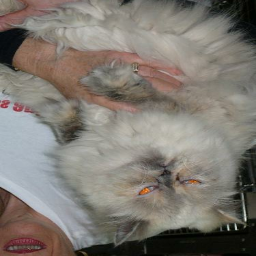

(256, 256, 3)


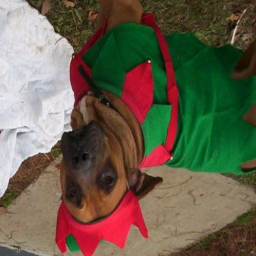

(256, 256, 3)


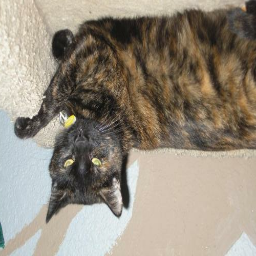

(256, 256, 3)


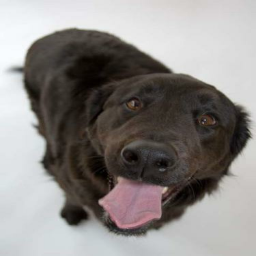

(256, 256, 3)


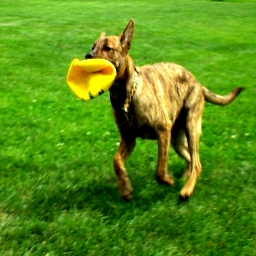

(256, 256, 3)


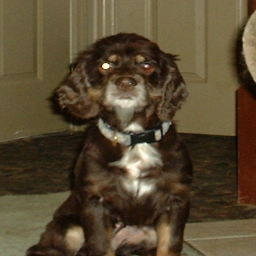

(256, 256, 3)


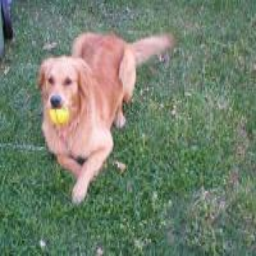

(256, 256, 3)


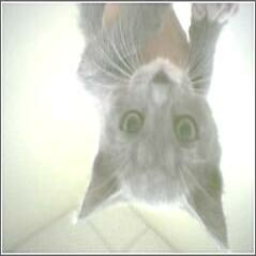

(256, 256, 3)


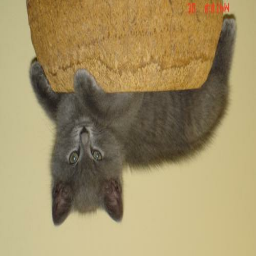

(256, 256, 3)


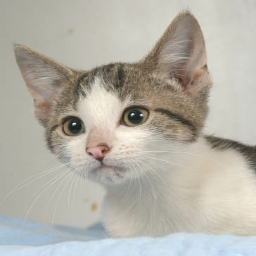

(256, 256, 3)


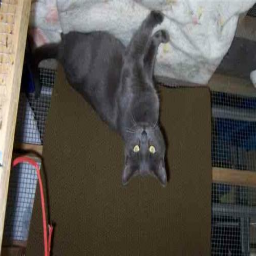

(256, 256, 3)


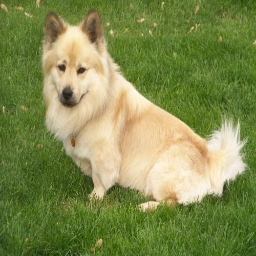

(256, 256, 3)


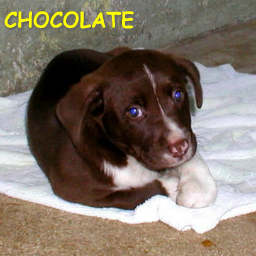

(256, 256, 3)


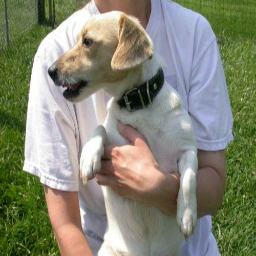

(256, 256, 3)


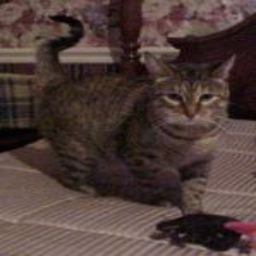

(256, 256, 3)


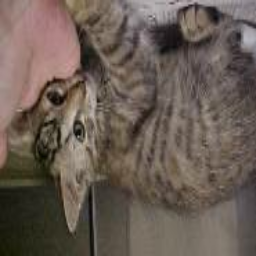

(256, 256, 3)


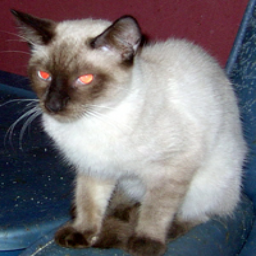

(256, 256, 3)


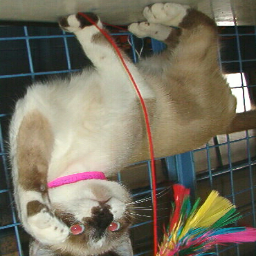

(256, 256, 3)


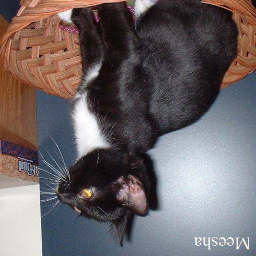

(256, 256, 3)


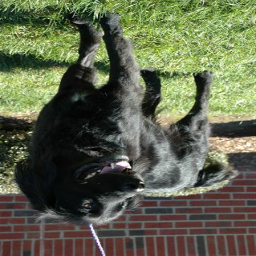

(256, 256, 3)


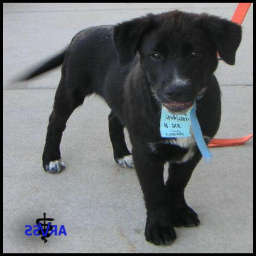

(256, 256, 3)


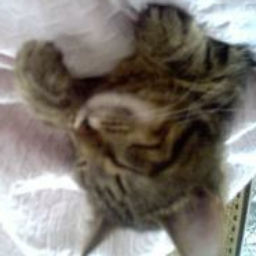

(256, 256, 3)


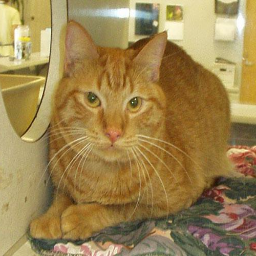

(256, 256, 3)


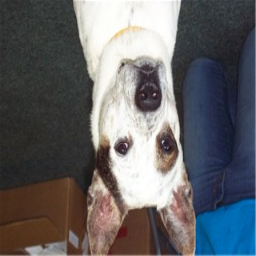

(256, 256, 3)


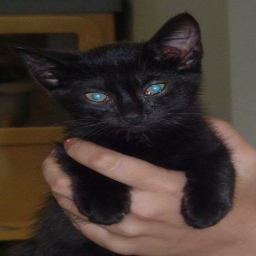

(256, 256, 3)


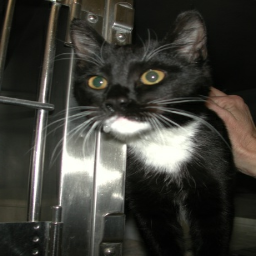

(256, 256, 3)


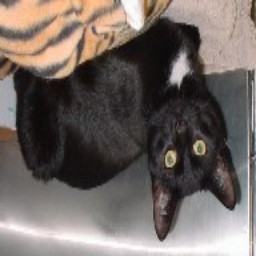

(256, 256, 3)


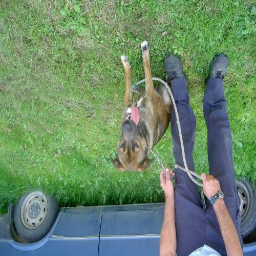

(256, 256, 3)


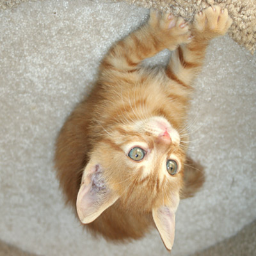

(256, 256, 3)


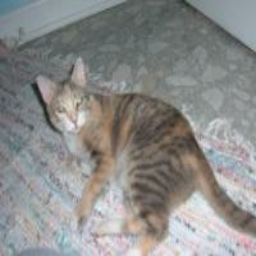

(256, 256, 3)


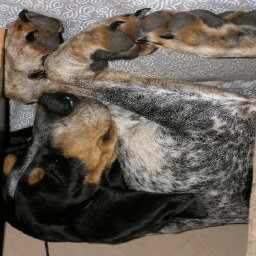

(256, 256, 3)


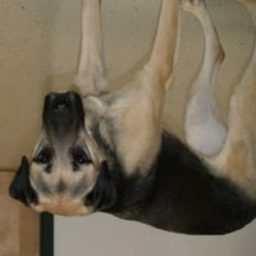

(256, 256, 3)


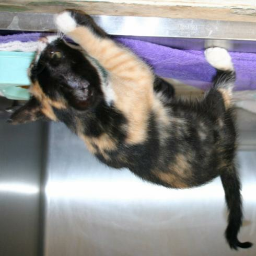

(256, 256, 3)


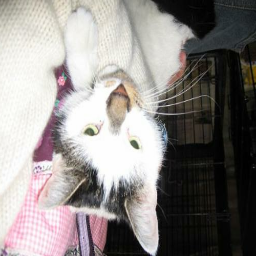

(256, 256, 3)


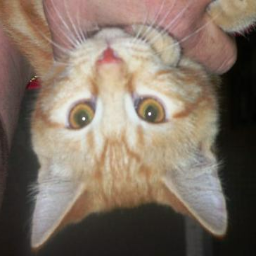

(256, 256, 3)


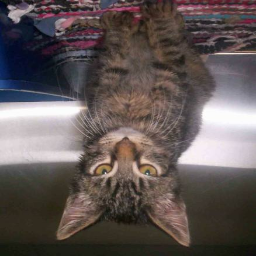

(256, 256, 3)


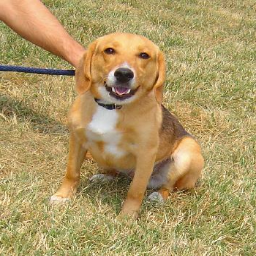

(256, 256, 3)


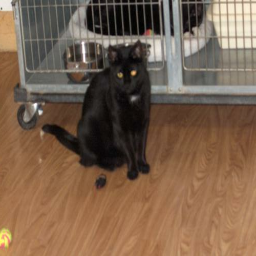

(256, 256, 3)


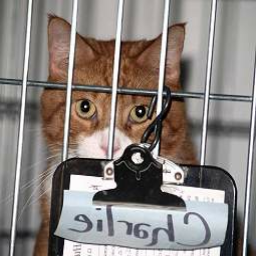

(256, 256, 3)


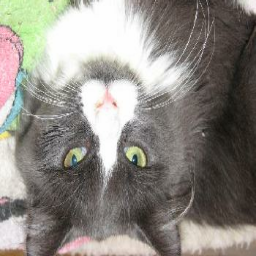

(256, 256, 3)


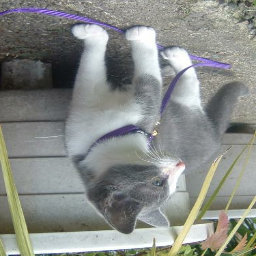

(256, 256, 3)


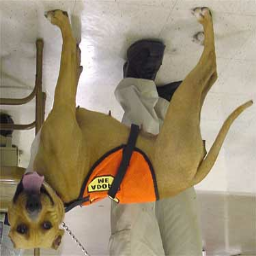

(256, 256, 3)


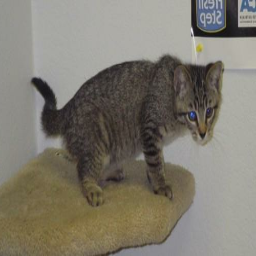

(256, 256, 3)


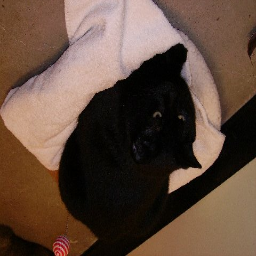

(256, 256, 3)


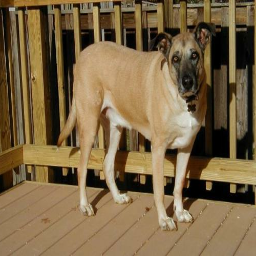

(256, 256, 3)


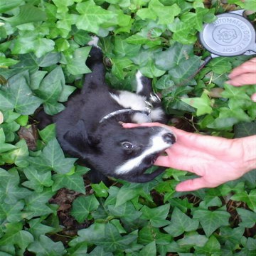

(256, 256, 3)


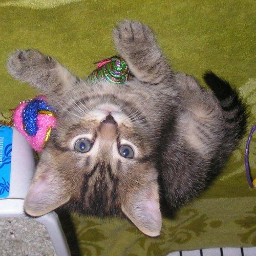

(256, 256, 3)


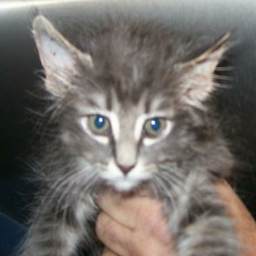

(256, 256, 3)


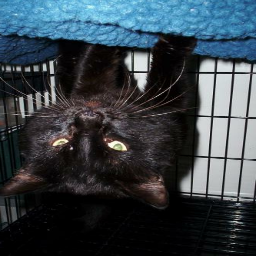

(256, 256, 3)


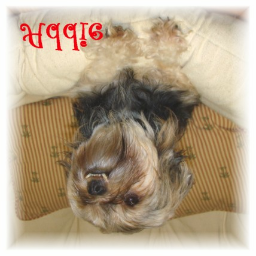

(256, 256, 3)


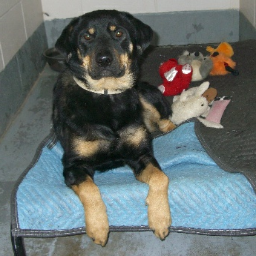

(256, 256, 3)


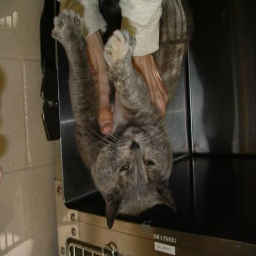

(256, 256, 3)


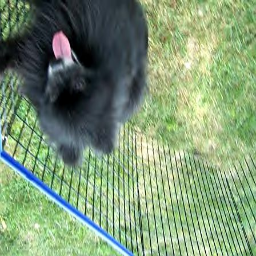

(256, 256, 3)


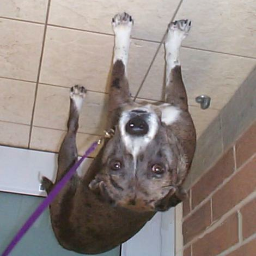

(256, 256, 3)


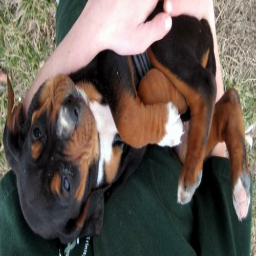

(256, 256, 3)


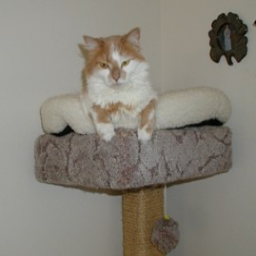

(256, 256, 3)


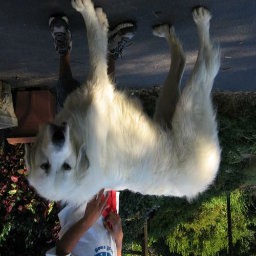

(256, 256, 3)


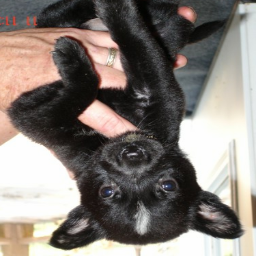

(256, 256, 3)


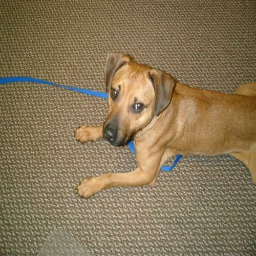

(256, 256, 3)


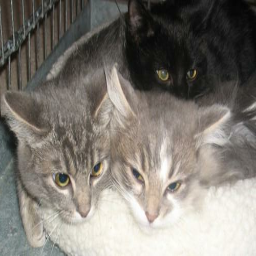

(256, 256, 3)


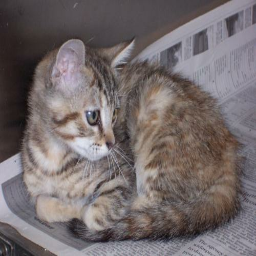

(256, 256, 3)


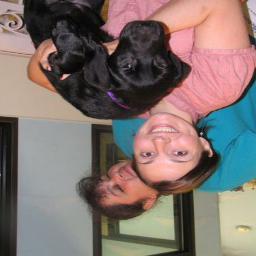

(256, 256, 3)


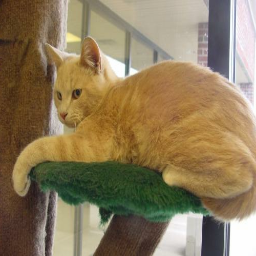

(256, 256, 3)


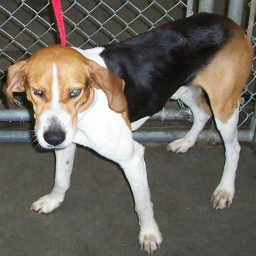

(256, 256, 3)


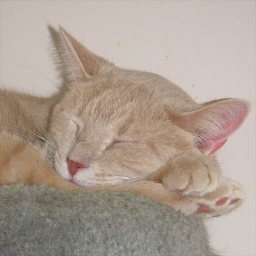

(256, 256, 3)


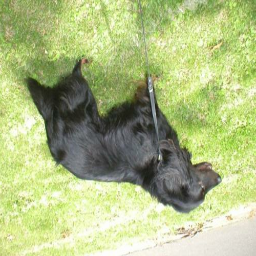

(256, 256, 3)


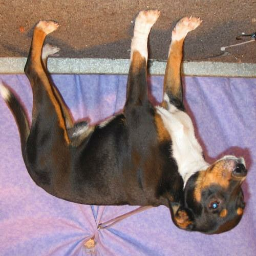

(256, 256, 3)


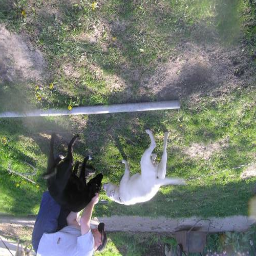

(256, 256, 3)


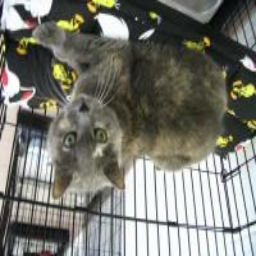

(256, 256, 3)


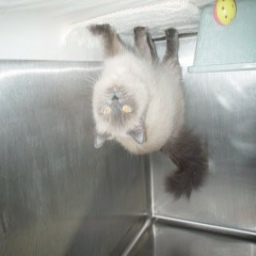

(256, 256, 3)


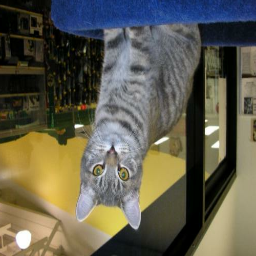

(256, 256, 3)


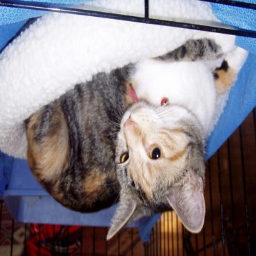

(256, 256, 3)


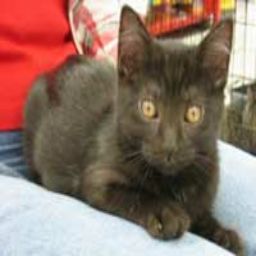

(256, 256, 3)


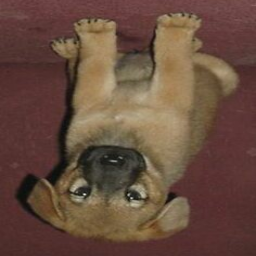

(256, 256, 3)


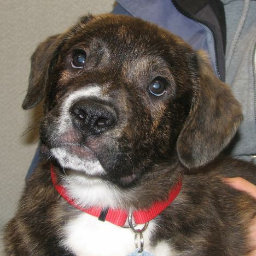

(256, 256, 3)


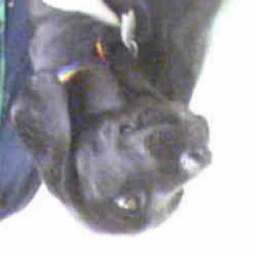

(256, 256, 3)


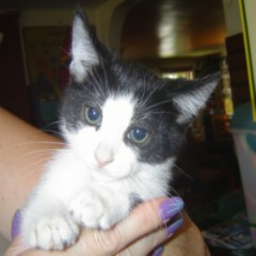

(256, 256, 3)


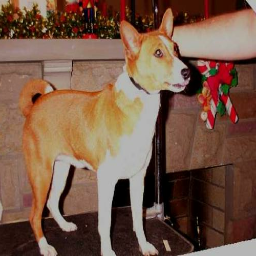

(256, 256, 3)


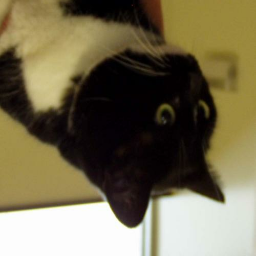

(256, 256, 3)


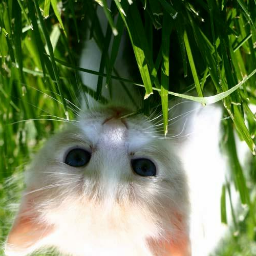

(256, 256, 3)


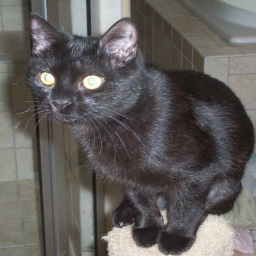

(256, 256, 3)


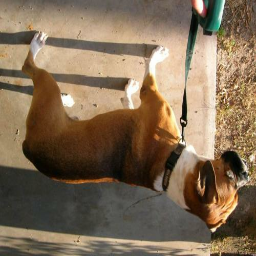

(256, 256, 3)


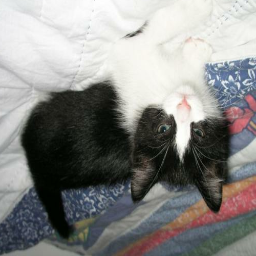

(256, 256, 3)


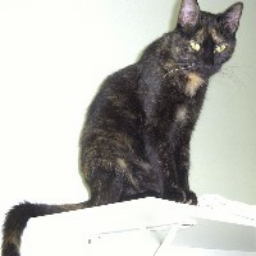

(256, 256, 3)


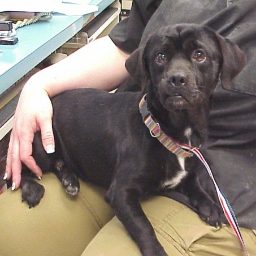

(256, 256, 3)


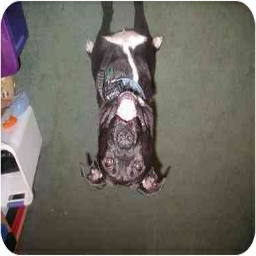

(256, 256, 3)


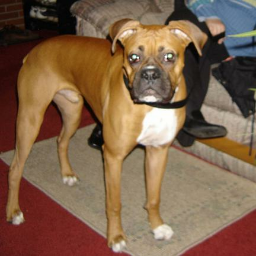

(256, 256, 3)


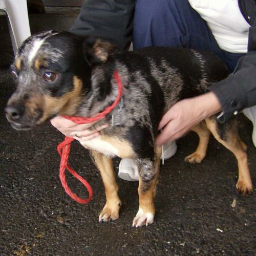

(256, 256, 3)


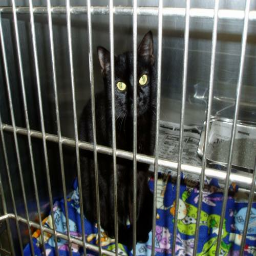

(256, 256, 3)


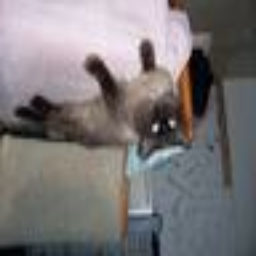

(256, 256, 3)


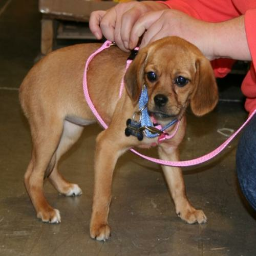

(256, 256, 3)


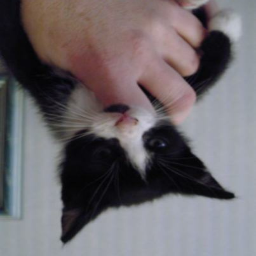

(256, 256, 3)


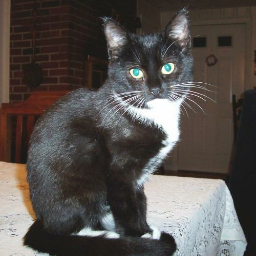

(256, 256, 3)


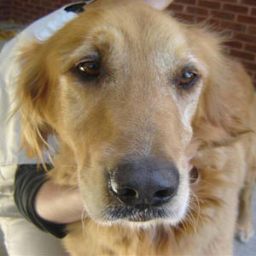

(256, 256, 3)


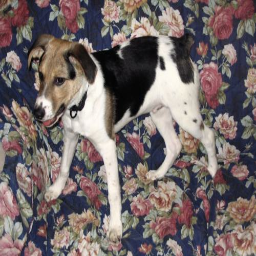

(256, 256, 3)


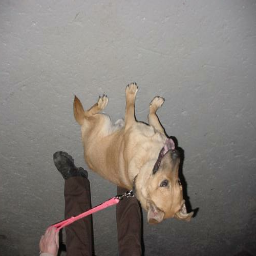

(256, 256, 3)


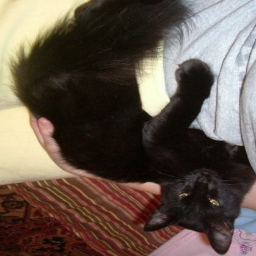

(256, 256, 3)


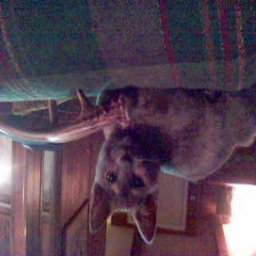

(256, 256, 3)


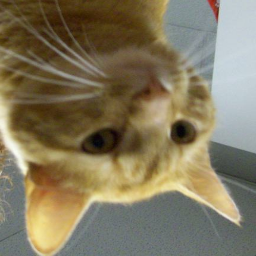

(256, 256, 3)


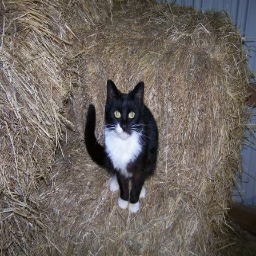

(256, 256, 3)


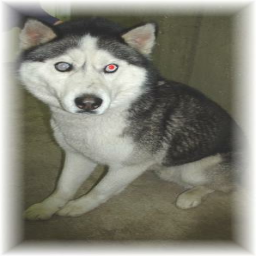

(256, 256, 3)


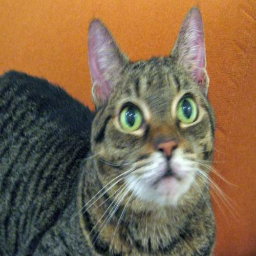

(256, 256, 3)


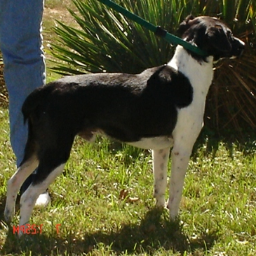

(256, 256, 3)


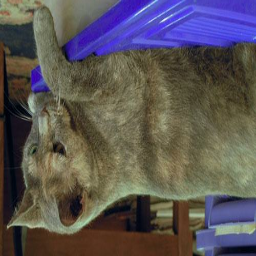

(256, 256, 3)


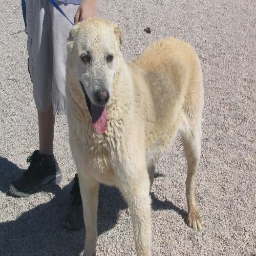

(256, 256, 3)


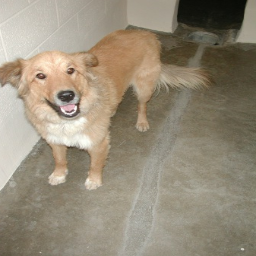

(256, 256, 3)


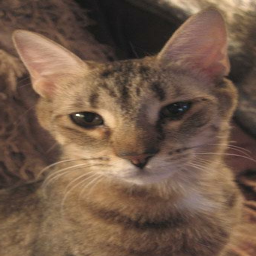

(256, 256, 3)


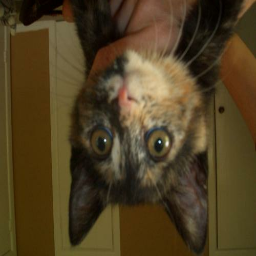

(256, 256, 3)


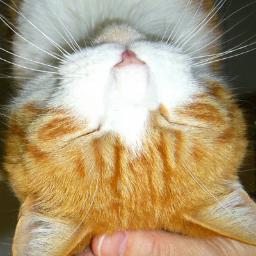

(256, 256, 3)


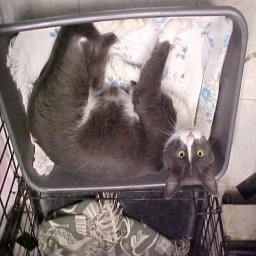

(256, 256, 3)


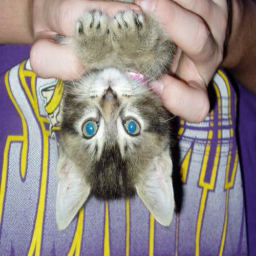

(256, 256, 3)


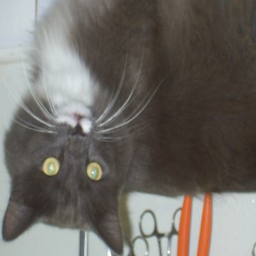

(256, 256, 3)


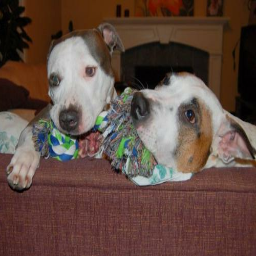

(256, 256, 3)


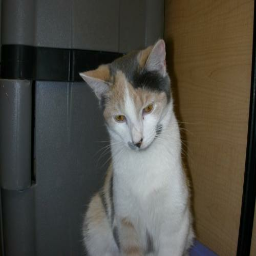

(256, 256, 3)


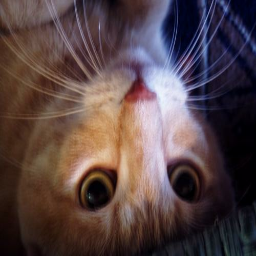

(256, 256, 3)


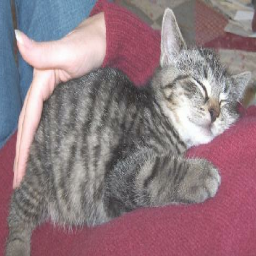

(256, 256, 3)


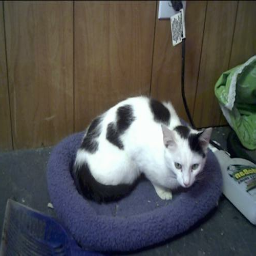

(256, 256, 3)


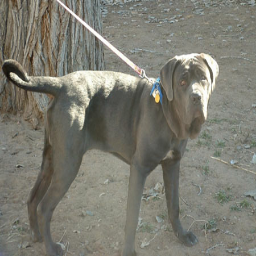

(256, 256, 3)


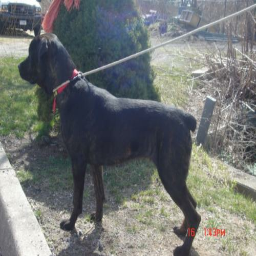

(256, 256, 3)


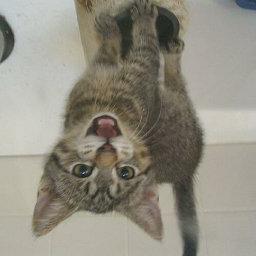

(256, 256, 3)


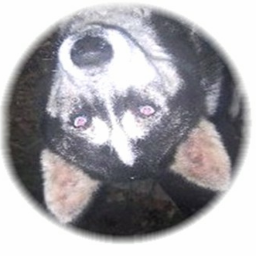

(256, 256, 3)


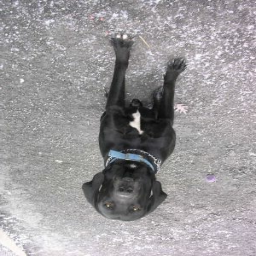

(256, 256, 3)


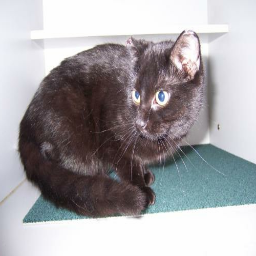

(256, 256, 3)


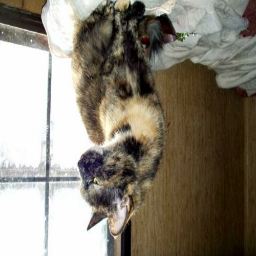

(256, 256, 3)


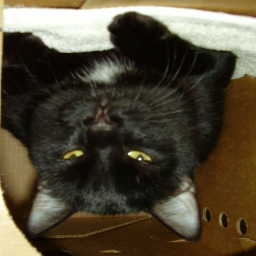

(256, 256, 3)


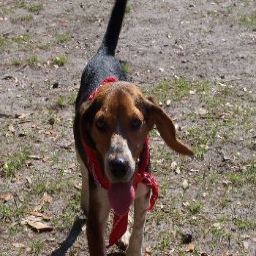

(256, 256, 3)


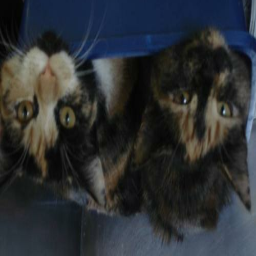

(256, 256, 3)


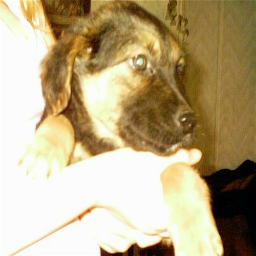

(256, 256, 3)


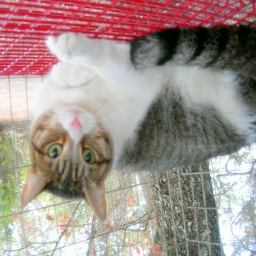

(256, 256, 3)


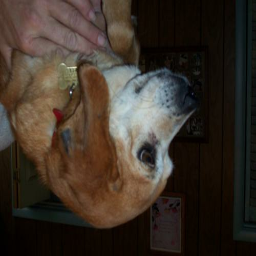

In [93]:
# batch 1개로 구성된 TakeDataset
for images, labels in preprocessing_dataset:

    for image in images:
        # rescale을 통해서 각 픽셀값이 0-255 -> 0-1 
        # 0-255의 값의 분포로 이미지를 인식하여 0-1사이의 값은 0으로 간주되어 매우 어둡게 나타난다.
        image_array = image.numpy().astype('uint8')
        print(image_array.shape)
        pil_image = PIL.Image.fromarray(image_array)
        display(pil_image)
        